In [200]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import random

In [201]:
PATH = 'logo_images'
images = []
file_names = os.listdir(PATH)

for i, name in enumerate(file_names):
    img = Image.open(os.path.join(PATH, name)).convert('RGBA')
    background = Image.new('RGBA', img.size, (255, 255, 255, 255))
    result = Image.alpha_composite(background, img).convert('RGB')
    result = result.resize((128, 128))
    images.append(result)

In [202]:
import imgaug.augmenters as iaa

os.makedirs('datas')

aug_pipe = iaa.Sequential([
    iaa.Flipud(0.5), 
    iaa.Rotate((-45, 45), cval=(255, 255)),
    iaa.GaussianBlur(sigma=(0, 3.0)) 
])

augs = []

for img in images:
    aug_img = aug_pipe(image=np.array(img))
    result = Image.fromarray(aug_img)
    augs.append(result)

datas = images + augs

for i, img in enumerate(datas):
    img.save(f'datas/image{i+1}.png', 'png')

In [248]:
dataroot = 'datas'

batch_size = 8

image_size = 224

RGB = 3

dimz = 100

num_epochs = 15

lr = 0.0002

beta1 = 0.5

In [249]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torch.utils.data import Dataset
import matplotlib.animation as animation


class Dataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_list = os.listdir(root_dir)

    def __len__(self):
        return len(self.image_list)

    def __getitem__(self, idx):
        img_name = os.path.join(self.root_dir, self.image_list[idx])
        image = Image.open(img_name)
        if self.transform:
            image = self.transform(image)
        return image
    
transform = transforms.Compose([
                            transforms.ToTensor(),
                            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                            ])

dataset = Dataset(dataroot, transform)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True)

device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

In [250]:
device

device(type='mps')

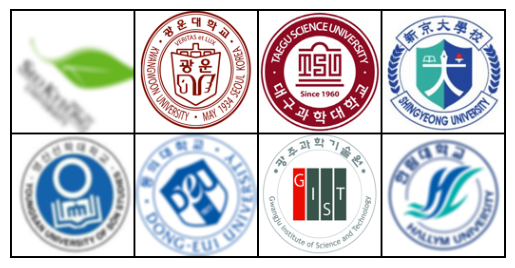

In [251]:
batch = next(iter(dataloader))
batch_norm = (batch + 1) / 2
grid = vutils.make_grid(batch_norm, nrow=4, padding=2, normalize=False)
grid_np = grid.cpu().numpy().transpose((1, 2, 0))
plt.imshow(grid_np)
plt.axis('off')
plt.show()

In [252]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [253]:
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        self.latent_dim = dimz
        self.main = nn.Sequential(
            nn.ConvTranspose2d(dimz, 512, 4, 2, 0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, 32, 4, 2, 1, bias=False),
            nn.BatchNorm2d(32),
            nn.ReLU(True),
            nn.ConvTranspose2d(32, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, z):
        return self.main(z)

In [254]:
Generator = Generator().to(device)

Generator.apply(weights_init)
print(Generator)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(2, 2), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchNorm2d(

In [255]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.main = nn.Sequential(
            nn.Conv2d(3, 32, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(32, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 512, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(512, 1, 4, 2, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.main(x)

In [256]:
Discriminator = Discriminator().to(device)

Discriminator.apply(weights_init)
print(Discriminator)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): LeakyReLU(negative_slope=0.2, i

In [257]:
criterion = nn.BCELoss()

init_noise = torch.randn(batch_size, dimz, 1, 1, device=device)

real_label = 1
fake_label = 0

optimizer_dis = optim.Adam(Discriminator.parameters(), lr=lr, betas=(beta1, 0.999))
optimizer_gen = optim.Adam(Generator.parameters(), lr=lr, betas=(beta1, 0.999))

In [258]:
imgs = []
G_losses = []
D_losses = []


for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):

        Discriminator.zero_grad()
        batch = data.to(device)
        batch_size = batch.size(0)
        label = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
        output = Discriminator(batch).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(batch_size, dimz, 1, 1, device=device)
        fake = Generator(noise)
        label.fill_(fake_label)
        output = Discriminator(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizer_dis.step()


        Generator.zero_grad()
        label.fill_(real_label)  
        output = Discriminator(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizer_gen.step()

        G_losses.append(errG.item())
        D_losses.append(errD.item())

        if (epoch == num_epochs-1):
            with torch.no_grad():
                fake = Generator(init_noise).detach().cpu()
            imgs.append(vutils.make_grid(fake, padding=2, normalize=True))

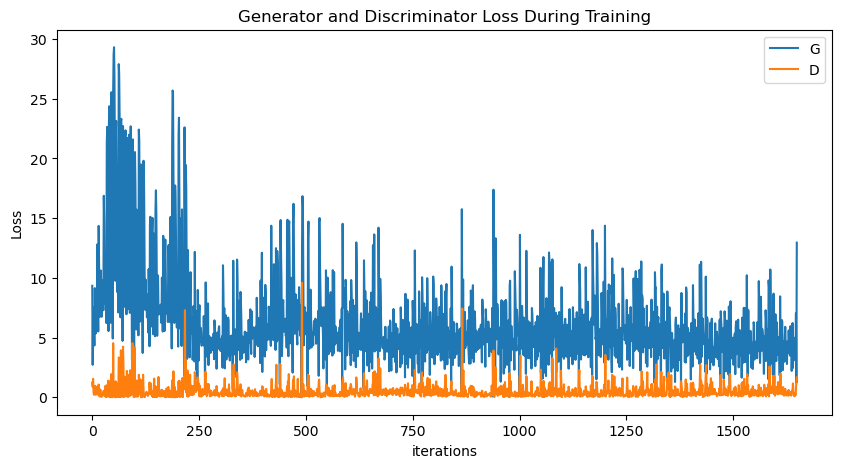

In [259]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

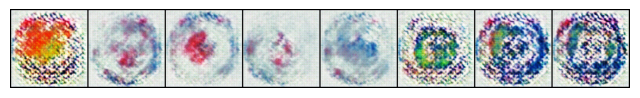

In [260]:
from IPython.display import HTML
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in imgs]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

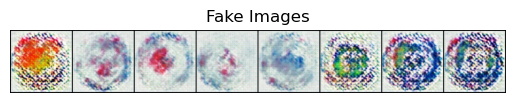

In [261]:
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(imgs[-1],(1,2,0)))
plt.show()